In [3]:

import requests
import json
import os
import time
import gspread
from datetime import datetime, timedelta
import pandas as pd
import numpy as np
from gspread.utils import rowcol_to_a1
import pandas as pd
from IPython.display import display
import random
from requests.exceptions import ReadTimeout, ConnectionError

from shapely.geometry import Point
import geopandas as gpd
import shapely
from shapely import affinity
import seaborn as sns

import geopandas as gpd
from shapely.geometry import Point
import matplotlib.pyplot as plt

from dotenv import load_dotenv
load_dotenv()
#ApiKey
yandex_code = os.getenv('url_geocoder_yandex')

print(f"[{datetime.now().strftime('%d.%m.%Y %H:%M:%S')}] Скрипт запущен")

[05.08.2025 09:02:23] Скрипт запущен


### Отфильтрованные данные

In [ ]:
# Подготовка сохранения итогового файла
output_path = '/Users/ad/Downloads/filtered_sorted.csv'
csv_path = '/Users/ad/Downloads/Реестр.csv'

In [ ]:
#Читаем CSV частями и фильтруем
# Делают тут чанками чтобы не уходить в другие инструменты, а учиться тут сразу. Скрывать не буду, чатик помог найти метод
filtered_chunks = []
chunksize = 100_000

for chunk in pd.read_csv(csv_path, chunksize=chunksize):
    filtered = chunk[
        (chunk['Тип субъекта'] == 'Юридическое лицо') &
        (chunk['Категория'].isin(['Малое предприятие', 'Среднее предприятие'])) &
        (chunk['Основной вид деятельности'] == '41.2 Строительство жилых и нежилых зданий')
    ]
    filtered_chunks.append(filtered)

# 4. Объединяем и сортируем
if filtered_chunks:
    result_df = pd.concat(filtered_chunks, ignore_index=True)
    result_df = result_df.sort_values(by='Категория')
else:
    result_df = pd.DataFrame()

# 5. Записываем в CSV по частям, чтобы избежать перезаписи
header = True
with open(output_path, 'w', encoding='utf-8', newline='') as f:
    for i, chunk in enumerate(filtered_chunks):
        chunk.to_csv(f, index=False, header=header, mode='a')
        header = False

print(output_path)

In [2]:
### Загружаем данные, которые отсортировались и имеют всё нужное

In [ ]:
# Подготовка сохранения итогового файла

In [61]:
# Сохраняем ИНН компаний в отдельный файл
data_filtered = pd.read_csv(output_path)
data_filtered.head(15)
data_inn = data_filtered['ИНН']
len(data_inn)

1646

In [ ]:
# Сохраняем отдельные значения карточек компаний, по которым дальше будем собирать данные
id_list = []
for i in data_inn:

    #Собираем данные по ИНН и id для открытия карточки
    session = requests.Session()
    headers = {
        "User-Agent": "Mozilla/5.0 (Windows NT 10.0; Win64; x64) "
                    "AppleWebKit/537.36 (KHTML, like Gecko) "
                    "Chrome/115.0.0.0 Safari/537.36",
        "Accept": "application/json",
        "Referer": "https://bo.nalog.ru/",
        "Origin": "https://bo.nalog.ru",
    }
    response = session.get(f"https://bo.nalog.gov.ru/advanced-search/organizations/search?query={i}&page=0&size=20",headers=headers)

    print(f"Status code: {response.status_code}")
    #print(f"Response text (first 500 chars): {response.text[:500]}")
    #print(response.json())
    response_json = response.json()
    for i in response_json['content']:
        row = {
            'ord_id': i['id']
        }
        id_list.append(row)

print(id_list)

Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 200
Status code: 2

In [9]:
# Сохраняем данные чтобы дальше продолжить работу с новой "точки сохранения"
with open('/Users/ad/Downloads/org_ids_again.json', 'w', encoding='utf-8') as f:
    json.dump(id_list, f, ensure_ascii=False, indent=2)

### Получаем данные из карточек компаний

In [62]:
# Проверяем что файл имеет нужную нам структуру
with open('/Users/ad/Downloads/org_ids_again.json', 'r', encoding='utf-8') as file:
    ord_ids = json.load(file)

print(ord_ids)

[{'ord_id': 5972153}, {'ord_id': 2996748}, {'ord_id': 5446585}, {'ord_id': 6019245}, {'ord_id': 6808260}, {'ord_id': 3971160}, {'ord_id': 1740}, {'ord_id': 6678813}, {'ord_id': 2142195}, {'ord_id': 2983708}, {'ord_id': 1807346}, {'ord_id': 3871323}, {'ord_id': 6935964}, {'ord_id': 5803013}, {'ord_id': 2197947}, {'ord_id': 6569696}, {'ord_id': 1281960}, {'ord_id': 2912700}, {'ord_id': 1982827}, {'ord_id': 7070666}, {'ord_id': 7024616}, {'ord_id': 1025772}, {'ord_id': 2793258}, {'ord_id': 4203459}, {'ord_id': 6598290}, {'ord_id': 7074171}, {'ord_id': 6950650}, {'ord_id': 95243}, {'ord_id': 10912902}, {'ord_id': 2053068}, {'ord_id': 1473581}, {'ord_id': 6862799}, {'ord_id': 7924471}, {'ord_id': 5504599}, {'ord_id': 7053371}, {'ord_id': 3360728}, {'ord_id': 1608630}, {'ord_id': 1454551}, {'ord_id': 5048106}, {'ord_id': 6842511}, {'ord_id': 155134}, {'ord_id': 5356324}, {'ord_id': 7668403}, {'ord_id': 6239342}, {'ord_id': 4986140}, {'ord_id': 6120830}, {'ord_id': 4574893}, {'ord_id': 600477

In [11]:
# Функция, которая защитит от падения парсинга данных, если он вдруг упадет
def safe_request(url,headers,retries=3,delay=3):
    for attempt in range(retries):
        try:
            response = requests.get(url,headers=headers,timeout=30)
            response.raise_for_status()
            return response
        except (ReadTimeout,ConnectionError) as e:
            time.sleep(delay)
    return None

In [ ]:
# Основной код, который собирает данные по компаниям и сохраняет их в отдельный лист
data_company = []

for i in ord_ids:
    ord_id = i.get('ord_id')
    if not ord_id:
        continue

    session = requests.Session()
    browsers = [
    "Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/115.0.0.0 Safari/537.36",
    "Mozilla/5.0 (Macintosh; Intel Mac OS X 13.4; rv:113.0) Gecko/20100101 Firefox/113.0",
    "Mozilla/5.0 (X11; Linux x86_64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/120.0.0.0 Safari/537.36",
    "Mozilla/5.0 (iPhone; CPU iPhone OS 16_5 like Mac OS X) AppleWebKit/605.1.15 (KHTML, like Gecko) Version/16.5 Mobile/15E148 Safari/604.1",
    ]

    url = f"https://bo.nalog.gov.ru/nbo/organizations/{ord_id}/bfo/"
    headers = {
        "User-Agent": random.choice(browsers),
        "Accept": "application/json",
        "Referer": "https://bo.nalog.ru/",
        "Origin": "https://bo.nalog.ru",
    }
    response = safe_request(url, headers=headers)
    if response is None:
        print(f'Пустой ответ {ord_id}')
        continue
    try:
        data_json = response.json()
    except ValueError:
        print(f'ошибка {ord_id}')
        continue

    for rec in data_json:
        corr = rec.get('typeCorrections', [])
        if corr and isinstance(corr, list):
            corr0 = corr[0].get('correction', {})
        else:
            corr0 = {}
        fin = corr0.get('financialResult', {})
        org_info = rec.get('organizationInfo') or {}
        
        #print(fin)
        #print(org_info)
        row = {
            'ID карточки': rec.get('id'),
            'Имя компании': org_info.get('fullName'),
            'ИНН': org_info.get('inn'),
            'Адрес': org_info.get('address'),
            'Период': rec.get('period'),
            'Выручка': fin.get('current2110'),
            'Себестоимость продаж': fin.get('current2120'),
            'Операционная прибыль': fin.get('current2200'), #EBIT
            'Чистая прибыль': fin.get('current2400'),
            'Налог на прибыль': fin.get('current2410'),
            'Проценты': fin.get('current2330'),
            'Амортизация': None  # подставьте, если есть
        }
        data_company.append(row)
    #print(data_company)
    print(len(data_company))

df_ebit = pd.DataFrame(data_company)
display(df_ebit)

{'id': 51658764, 'okud': '0710002', 'current2220': 78912.0, 'previous2220': 60877.0, 'current2200': 15204.0, 'previous2200': 20463.0, 'current2320': 347.0, 'previous2320': 50.0, 'current2340': 7403.0, 'previous2340': 16363.0, 'current2350': 16659.0, 'previous2350': 30283.0, 'current2300': 6295.0, 'previous2300': 6593.0, 'current2410': -2629.0, 'previous2410': -6139.0, 'current2400': 3594.0, 'previous2400': 454.0, 'current2411': 2629.0, 'previous2411': 6139.0, 'current2460': -72.0, 'current2500': 3594.0, 'previous2500': 454.0, 'current2110': 930280.0, 'previous2110': 594302.0, 'current2120': 836164.0, 'previous2120': 512962.0, 'current2100': 94116.0, 'previous2100': 81340.0}
{'fullName': 'Общество с ограниченной ответственностью "ЛАВИНА"', 'inn': '5027064258', 'kpp': '502701001', 'address': '140015, Московская обл, город Люберцы, Инициативная ул, дом № 10', 'okved2_id': '41.20', 'okved2': {'id': '41.20', 'name': 'Строительство жилых и нежилых зданий'}, 'okopf_id': 12300, 'okopf': {'id':

,ID карточки,Имя компании,ИНН,Адрес,Период,Выручка,Себестоимость продаж,Операционная прибыль,Чистая прибыль,Налог на прибыль,Проценты,Амортизация
0,24317325,"Общество с ограниченной ответственностью ""ЛАВИНА""",5027064258,"140015, Московская обл, город Люберцы, Инициат...",2024,930280.0,836164.0,15204.0,3594.0,-2629.0,NaN,None
1,22182471,"Общество с ограниченной ответственностью ""ЛАВИНА""",5027064258,"140015, Московская обл, город Люберцы, Инициат...",2023,594302.0,512962.0,20463.0,454.0,-6139.0,NaN,None
2,18622398,"Общество с ограниченной ответственностью ""ЛАВИНА""",5027064258,"140015, Московская обл, город Люберцы, Инициат...",2022,253804.0,220644.0,-6868.0,2339.0,-729.0,NaN,None
3,14925267,"Общество с ограниченной ответственностью ""ЛАВИНА""",5027064258,"140015, Московская обл, Люберцы г, Инициативна...",2021,249375.0,195335.0,10707.0,3984.0,-737.0,NaN,None
4,7098597,"Общество с ограниченной ответственностью ""ЛАВИНА""",5027064258,"140015, Московская обл, Люберцы г, Инициативна...",2020,434461.0,382379.0,-777.0,3836.0,-1438.0,NaN,None
...,...,...,...,...,...,...,...,...,...,...,...,...
8043,24645325,"УПРАВЛЕНИЕ МЕХАНИЗИРОВАННЫХ РАБОТ "" КАСКАД "" (...",2301032458,"353407, Краснодарский край, Анапский р-н, Сукк...",2024,3049.0,3354.0,-305.0,-305.0,NaN,NaN,None
8044,20649013,"УПРАВЛЕНИЕ МЕХАНИЗИРОВАННЫХ РАБОТ "" КАСКАД "" (...",2301032458,"353407, Краснодарский край, Анапский р-н, Сукк...",2023,9009.0,25179.0,-16170.0,-16170.0,NaN,NaN,None
8045,18489613,"УПРАВЛЕНИЕ МЕХАНИЗИРОВАННЫХ РАБОТ "" КАСКАД "" (...",2301032458,"353407, Краснодарский край, Анапский р-н, Сукк...",2022,25739.0,33532.0,-7793.0,-7793.0,0.0,NaN,None
8046,15059514,"Управление Механизированных работ "" Каскад"" ООО",2301032458,"643,353407,23,Анапский,,с Сукко,Киблерова,16-а,,",2021,44640.0,42640.0,2000.0,1600.0,-400.0,NaN,None


In [ ]:
#Сохраняем табличку чтобы не потерялась вместе с EBIT
df_ebit.to_csv('/Users/ad/Downloads/data_info_base_ebit.csv', index=False, encoding='utf-8')

In [274]:
df_ebit = pd.read_csv('/Users/ad/Downloads/data_info_base_ebit.csv')

<function matplotlib.pyplot.show(close=None, block=None)>

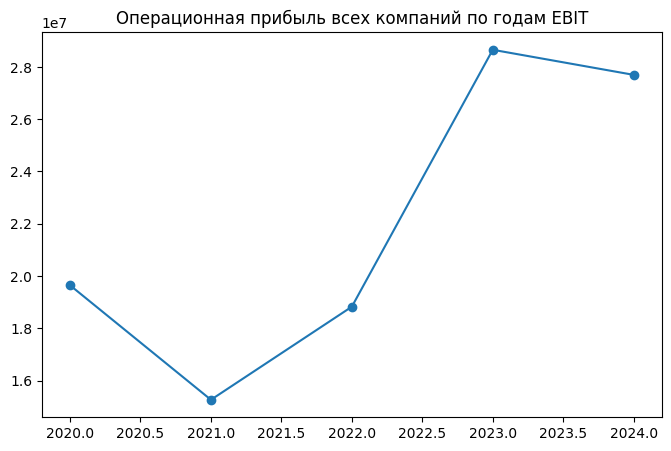

In [ ]:
# Посмотрел, что в сумме по годам, как видим операционная прибыль растёт
group_by_year = df_ebit.groupby(['Период'])['Операционная прибыль'].sum()
years = group_by_year.index
profits = group_by_year.values

plt.figure(figsize=(8, 5))
plt.plot(years, profits, marker='o')
plt.title("Операционная прибыль всех компаний по годам EBIT")
plt.show

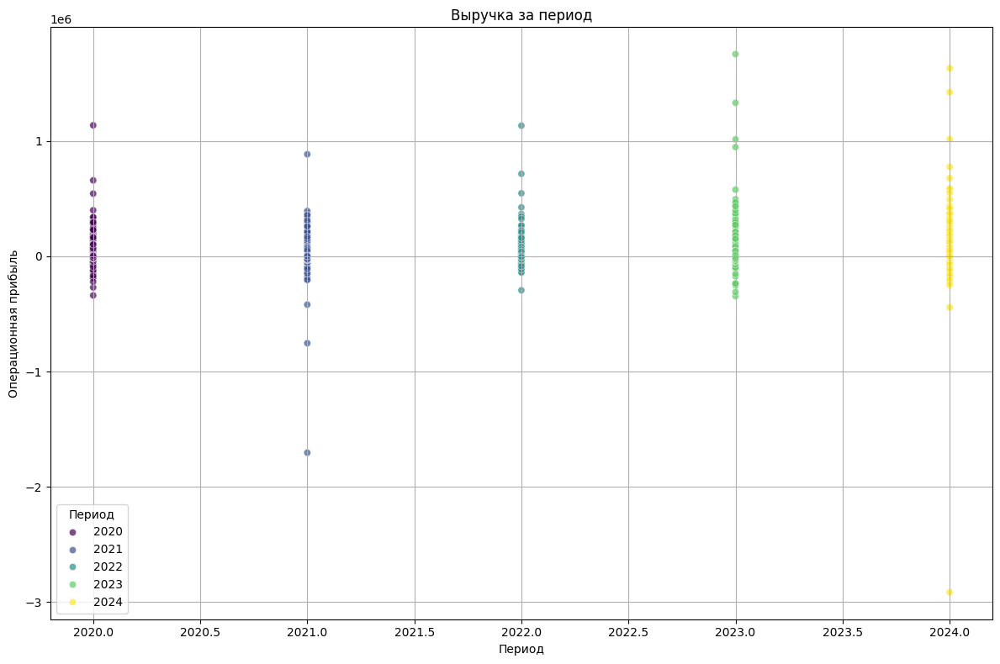

In [ ]:
df_ebit = pd.read_csv('/Users/ad/Downloads/data_info_base_ebit.csv')
df_ebit = df_ebit.dropna(subset=['Выручка', 'Операционная прибыль'])

# Строим scatter plot
plt.figure(figsize=(12,8))
sns.scatterplot(
    data=df_ebit,
    x='Период',
    y='Операционная прибыль',
    hue='Период',
    palette='viridis',
    sizes=(20, 200),
    alpha=0.7
)

plt.title('Выручка за период')
plt.xlabel('Период')
plt.ylabel('Операционная прибыль')
plt.grid(True)
plt.tight_layout()
plt.show()

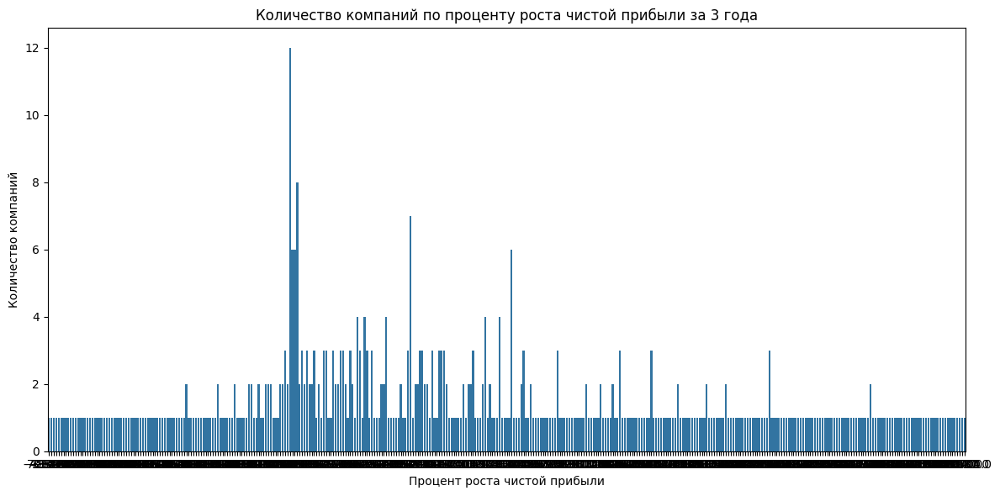

In [ ]:
# Теперь выполним задание с процентым ростом за определенный период
df_current = df_ebit[df_ebit['Период'] == 2024]
#display(df_current)
df_previous = df_ebit[df_ebit['Период'] == 2021].head(1514)
#display(df_previous)

# Соединим полученные данные и вычислим значениям
df_merged = pd.merge(df_current, df_previous, on='Имя компании', suffixes=('_cur', '_prev'))
df_merged = df_merged[df_merged['Чистая прибыль_prev'] != 0]
df_merged['Рост прибыли (%)'] = ((df_merged['Чистая прибыль_cur'] - df_merged['Чистая прибыль_prev']) / df_merged['Чистая прибыль_prev']) * 100

# Округлим
df_merged['Рост прибыли (%)'] = df_merged['Рост прибыли (%)'].round()

growth_counts = df_merged['Рост прибыли (%)'].value_counts().reset_index()
growth_counts.columns = ['Процент роста', 'Количество компаний']
growth_counts = growth_counts.sort_values('Процент роста')

plt.figure(figsize=(12, 6))
sns.barplot(x='Процент роста', y='Количество компаний', data=growth_counts)
plt.title(f'Количество компаний по проценту роста чистой прибыли за 3 года')
plt.xlabel('Процент роста чистой прибыли')
plt.ylabel('Количество компаний')
plt.tight_layout()
plt.show()

#Вывод: Ничего не понятно, по ощущениям ничего не изменилось

### Анализируем данные и получаем топ 500 компаний

In [269]:
df = pd.read_csv('/Users/ad/Downloads/top500_by_clear_revenue.csv')

In [270]:
# Превращаем даты из столба "Период" в даты
df_new = df.copy()
#display(df_new)
df_new_sort = df_new.sort_values(by='Чистая прибыль',ascending=False).head(500)
df_new_sort = df_new_sort.reset_index()
df_new_sort.drop('index',axis=1,inplace=True)

In [ ]:
df_new_sort.to_csv('/Users/ad/Downloads/top500_by_clear_revenue.csv', index=False, encoding='utf-8')

In [195]:
# Геокодер яндекс
data_geo_data = []
url_geocoder = '315f2934-cd9b-4532-ae65-77d101e606db'

for i in df_new_sort['Адрес']:
    geozaproc = i
    session = requests.Session()
    response = session.get(f"https://geocode-maps.yandex.ru/v1/?apikey={url_geocoder}&geocode={geozaproc}&format=json")
    print(response.status_code)  
    response_json = response.json()
    row = {
        'Адрес': response_json['response']['GeoObjectCollection']['metaDataProperty']['GeocoderResponseMetaData']['request'],
        'coordinates_nes': response_json['response']['GeoObjectCollection']['featureMember'][0]['GeoObject']['Point']['pos'].split(),
        #'lat2': response_json['response']['GeoObjectCollection']['featureMember'][0]['GeoObject']['Point']['pos'].split()[0],
    }
    data_geo_data.append(row)

df_data_geo = pd.DataFrame(data_geo_data)
display(df_data_geo)

200
[{'Адрес': '385200, Адыгея Респ, р-н Теучежский, х Кочкин, ул Логистическая, 3, 1, 146', 'coordinates_nes': ['39.183758', '44.866224']}]
200
[{'Адрес': '385200, Адыгея Респ, р-н Теучежский, х Кочкин, ул Логистическая, 3, 1, 146', 'coordinates_nes': ['39.183758', '44.866224']}, {'Адрес': '125167, Город Москва, вн.тер.г. муниципальный округ Аэропорт, ул Планетная, д. 11, помещ. 2/1', 'coordinates_nes': ['37.617644', '55.755819']}]
200
[{'Адрес': '385200, Адыгея Респ, р-н Теучежский, х Кочкин, ул Логистическая, 3, 1, 146', 'coordinates_nes': ['39.183758', '44.866224']}, {'Адрес': '125167, Город Москва, вн.тер.г. муниципальный округ Аэропорт, ул Планетная, д. 11, помещ. 2/1', 'coordinates_nes': ['37.617644', '55.755819']}, {'Адрес': '344002, Ростовская обл, г Ростов-на-Дону, пр-кт Буденновский, зд 36, 406', 'coordinates_nes': ['39.707979', '47.221595']}]
200
[{'Адрес': '385200, Адыгея Респ, р-н Теучежский, х Кочкин, ул Логистическая, 3, 1, 146', 'coordinates_nes': ['39.183758', '44.866

,Адрес,coordinates_nes
0,"385200, Адыгея Респ, р-н Теучежский, х Кочкин,...","[39.183758, 44.866224]"
1,"125167, Город Москва, вн.тер.г. муниципальный ...","[37.617644, 55.755819]"
2,"344002, Ростовская обл, г Ростов-на-Дону, пр-к...","[39.707979, 47.221595]"
3,"344002, Ростовская обл, г Ростов-на-Дону, пр-к...","[39.707979, 47.221595]"
4,"385200, Адыгея Респ, р-н Теучежский, х Кочкин,...","[39.183758, 44.866224]"
...,...,...
495,"164500, Архангельская обл, г.Северодвинск, пр-...","[39.780446, 64.540491]"
496,"Пермский край, г. Березники, ул. Карла Маркса,...","[56.815181, 59.427064]"
497,"628401, Ханты-Мансийский Автономный округ - Юг...","[73.393032, 61.241778]"
498,"643,241022,32,,Брянск г,,Речная ул,99,А,401","[34.366947, 53.289125]"


In [196]:
df_data_geo.to_csv('/Users/ad/Downloads/df_data_geo_new.csv', index=False, encoding='utf-8')

In [224]:
# Создаем единый датафрейм с координатами
df_result = pd.merge(df_new_sort, df_data_geo, how='inner',on='Адрес')

,ID карточки,Имя компании,ИНН,Адрес,Период,Чистая прибыль,Налог на прибыль,Проценты,Амортизация,coordinates_nes
0,21224841,ОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕННОСТЬЮ СПЕЦИ...,2312189274,"385200, Адыгея Респ, р-н Теучежский, х Кочкин,...",2023-01-01,2748049.0,-687134.0,193852.0,None,"[39.183758, 44.866224]"
1,21224841,ОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕННОСТЬЮ СПЕЦИ...,2312189274,"385200, Адыгея Респ, р-н Теучежский, х Кочкин,...",2023-01-01,2748049.0,-687134.0,193852.0,None,"[39.183758, 44.866224]"
2,22456605,"Общество с ограниченной ответственностью ""АГИД...",7704700820,"125167, Город Москва, вн.тер.г. муниципальный ...",2023-01-01,2038663.0,-18856.0,16657.0,None,"[37.617644, 55.755819]"
3,22456605,"Общество с ограниченной ответственностью ""АГИД...",7704700820,"125167, Город Москва, вн.тер.г. муниципальный ...",2023-01-01,2038663.0,-18856.0,16657.0,None,"[37.617644, 55.755819]"
4,24837296,"АКЦИОНЕРНОЕ ОБЩЕСТВО ""СПЕЦИАЛИЗИРОВАННЫЙ ЗАСТР...",6167065479,"344002, Ростовская обл, г Ростов-на-Дону, пр-к...",2024-01-01,1401826.0,-358459.0,1623.0,None,"[39.707979, 47.221595]"
...,...,...,...,...,...,...,...,...,...,...
771,25228947,"Общество с ограниченной ответственностью ""Союз...",5911011870,"Пермский край, г. Березники, ул. Карла Маркса,...",2024-01-01,56935.0,-14250.0,454.0,None,"[56.815181, 59.427064]"
772,24552933,"ОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕННОСТЬЮ ""ПРОМ...",8617030514,"628401, Ханты-Мансийский Автономный округ - Юг...",2024-01-01,56728.0,-15532.0,23797.0,None,"[73.393032, 61.241778]"
773,6783638,"Общество с ограниченной ответственностью ""БСК-...",3233500724,"643,241022,32,,Брянск г,,Речная ул,99,А,401",2020-01-01,56375.0,NaN,NaN,None,"[34.366947, 53.289125]"
774,7463303,"ОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕННОСТЬЮ ""КИКГ...",7709918820,"109004, Москва г, ул Земляной Вал, 65, 59",2020-01-01,56308.0,-14076.0,NaN,None,"[37.656658, 55.747946]"


In [225]:
# Создаем единый столбец с кординатами
df_result['coordinates_nes'] = df_result['coordinates_nes'].apply(Point) #Но их дальше надо переставить местами

In [230]:
df_result_new = df_result.copy()

In [228]:
import geopandas as gpd
from shapely.geometry import Point
import matplotlib.pyplot as plt

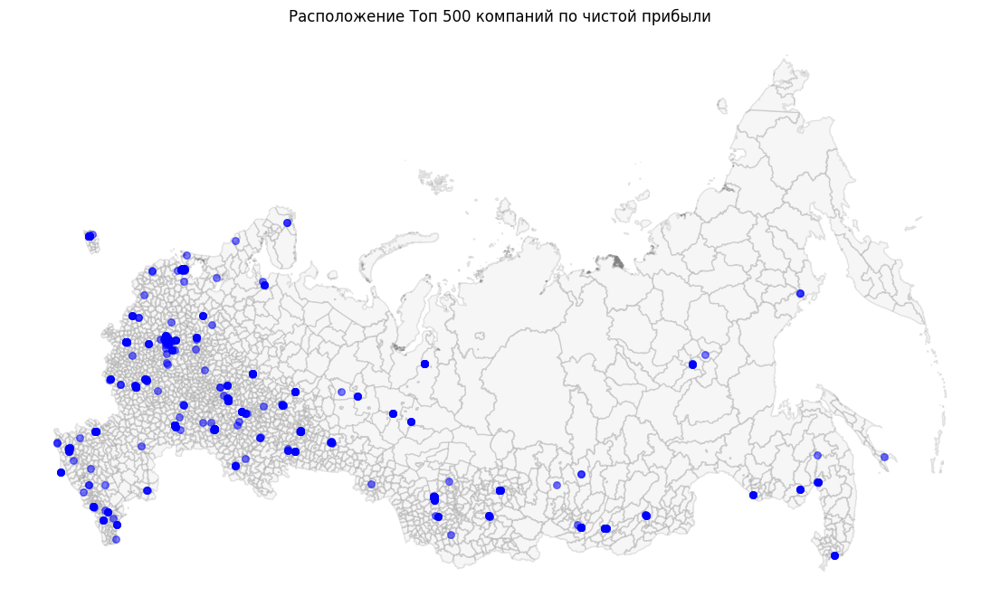

In [255]:
map_df=gpd.read_file('/Users/ad/Downloads/geoBoundaries-RUS-ADM2_simplified.geojson') 
gdf_regions = map_df.to_crs('EPSG:32646') # Помощь куратора

# Делаем GeoDataFrame
gdf_points = gpd.GeoDataFrame(df_result_new, geometry='coordinates_nes', crs='EPSG:4326')

# Переводим точки в EPSG:32646 (ту же проекцию, что и карта)
gdf_points_utm = gdf_points.to_crs('EPSG:32646')

# Строим
fig, ax = plt.subplots(figsize=(14, 10))

# Регионы
gdf_regions.plot(ax=ax, color='lightgray', edgecolor='gray', alpha=0.2)
# Точки компаний
gdf_points_utm.plot(ax=ax, color='blue', markersize=30, alpha=0.5)

ax.set_title('Расположение Топ 500 компаний по чистой прибыли')
ax.set_axis_off()

plt.show()